In [1]:
!pip install docx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
pip install pdfminer.six


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
pip install docx2txt


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
pip install constants

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
pip install docxpy


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
pip install textract


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [8]:
!pip install scikit-learn==0.24.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [9]:
!pip install --upgrade numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [10]:
# Importing 
# Libraries
import plotly.io as pio
import seaborn as sns
sns.set_style('darkgrid')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from pdfminer.converter import TextConverter
from pdfminer.pdfinterp import PDFPageInterpreter
from pdfminer.pdfinterp import PDFResourceManager
from pdfminer.layout import LAParams
from pdfminer.pdfpage import PDFPage
import spacy
import io
from spacy.matcher import Matcher
import pandas as pd
import re
from nltk.corpus import stopwords
import constants as cs
import datetime
from datetime import datetime
from dateutil import relativedelta
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('stopwords')
import docx2txt
import subprocess
import docxpy
import shutil

import re
import time
import string
import warnings
from tqdm.notebook import tqdm_notebook
import os,re
import textract as tr

# for all NLP related operations on text 
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import *
from nltk.stem.porter import PorterStemmer
from wordcloud import WordCloud, STOPWORDS
from collections import Counter

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# To identify the sentiment of text
from textblob import TextBlob
from textblob.sentiments import NaiveBayesAnalyzer
from textblob.np_extractors import ConllExtractor

from sklearn.feature_extraction.text import CountVectorizer 
from nltk.tokenize import RegexpTokenizer

# ignoring all the warnings
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=DeprecationWarning)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [11]:
import os

def count_files_with_extensions(directory):
    docx_file = 0
    pdf_file = 0
    doc_file = 0
    
    for root, dirs, files in os.walk(directory):
        for file in files:
            file_extension = os.path.splitext(file)[1]
            
            if file_extension == '.docx':
                docx_file += 1
            elif file_extension == '.pdf':
                pdf_file += 1
            elif file_extension == '.doc':
                doc_file += 1
    
    return docx_file, pdf_file, doc_file

# Specify the directory path
directory_path = "/content/drive/MyDrive/Resumes"

# Call the count_files_with_extensions function with the specified directory
docx_file, pdf_file, doc_file = count_files_with_extensions(directory_path)

# Print the counts
print(f"Number of .docx files: {docx_file}")
print(f"Number of .pdf files: {pdf_file}")
print(f"Number of .doc files: {doc_file}")


Number of .docx files: 50
Number of .pdf files: 1
Number of .doc files: 26


In [12]:
(docx_file)+(doc_file)+(pdf_file)

77

In [13]:
['docx_file','doc_file','pdf_file']

['docx_file', 'doc_file', 'pdf_file']

In [14]:
%matplotlib inline

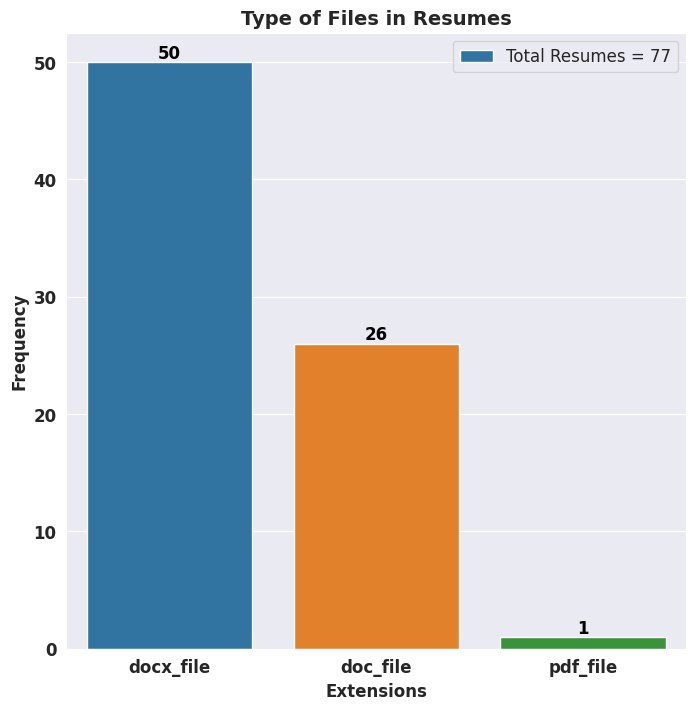

In [15]:
f, axe = plt.subplots(1,1, figsize=(8,8), dpi=100)
ax = sns.barplot(x=['docx_file','doc_file','pdf_file'], y=[(docx_file),(doc_file),(pdf_file)], ax = axe
            ,label='Total Resumes = {}'.format((docx_file)+(doc_file)+(pdf_file)))
axe.set_xlabel('Extensions', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=12,fontweight = 'bold')
plt.xticks(fontsize=12,fontweight = 'bold')
plt.legend(loc='best', fontsize  = 'large')
plt.title('Type of Files in Resumes', fontsize = 14, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 12)
plt.show()

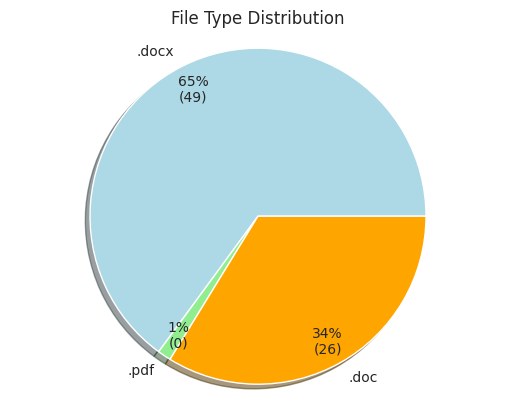

In [16]:
import os
import matplotlib.pyplot as plt

def count_files_with_extensions(directory):
    docx_count = 0
    pdf_count = 0
    doc_count = 0
    
    for root, dirs, files in os.walk(directory):
        for file in files:
            file_extension = os.path.splitext(file)[1]
            
            if file_extension == '.docx':
                docx_count += 1
            elif file_extension == '.pdf':
                pdf_count += 1
            elif file_extension == '.doc':
                doc_count += 1
    
    return docx_count, pdf_count, doc_count

# Specify the directory path
directory_path = "/content/drive/MyDrive/Resumes"

# Call the count_files_with_extensions function with the specified directory
docx_count, pdf_count, doc_count = count_files_with_extensions(directory_path)

# Calculate the total count of files
total_count = docx_count + pdf_count + doc_count

# Create the pie chart
labels = ['.docx', '.pdf', '.doc']
sizes = [docx_count, pdf_count, doc_count]
colors = ['lightblue', 'lightgreen', 'orange']

# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct=lambda pct: f"{pct:.0f}%\n({int(pct * total_count / 100)})",
        shadow=True, pctdistance=0.85)

plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title("File Type Distribution")
plt.show()


In [17]:
import glob

file_path = r'/content/drive/MyDrive/Resumes_docx'
file_name = []
profile = []

# Recursive search for all .docx files within file_path
for file in glob.glob(file_path + '/**/*.docx', recursive=True):
    folder_path = os.path.dirname(file)
    folder_name = os.path.basename(folder_path)
    profile.append(folder_name)
    file_name.append(os.path.basename(file))


In [18]:
data = pd.DataFrame()
data['Resumes'] = file_name
data['Profile'] = profile
data

,Resumes,Profile
0,SSKumar_Hexaware.docx,Workday
1,Vinay Kumar_Hexaware.docx,Workday
2,Venkateswarlu B_Hexaware.docx,Workday
3,Srikanth-Hexaware.docx,Workday
4,J. Sumanth Royal_Hexaware.docx,Workday
...,...,...
72,Peoplesoft Admin_Vinod Akkala.docx,Peoplesoft Admin
73,Peoplesoft Admin_Murali.docx,Peoplesoft Admin
74,Peoplesoft Admin_Gangareddy.docx,Peoplesoft Admin
75,Peoplesoft Admin_G Ananda Rayudu.docx,Peoplesoft Admin


In [19]:
data.Profile.value_counts().index

Index(['Workday', 'SQL Developer', 'React JS Developer', 'React Developer',
       'Peoplesoft Admin', 'Peoplesoft FSCM', 'Peoplesoft Finance',
       'Peoplesoft DBA'],
      dtype='object')

In [20]:
data.Profile.value_counts()

Workday               21
SQL Developer         14
React JS Developer    11
React Developer       11
Peoplesoft Admin       9
Peoplesoft FSCM        6
Peoplesoft Finance     3
Peoplesoft DBA         2
Name: Profile, dtype: int64

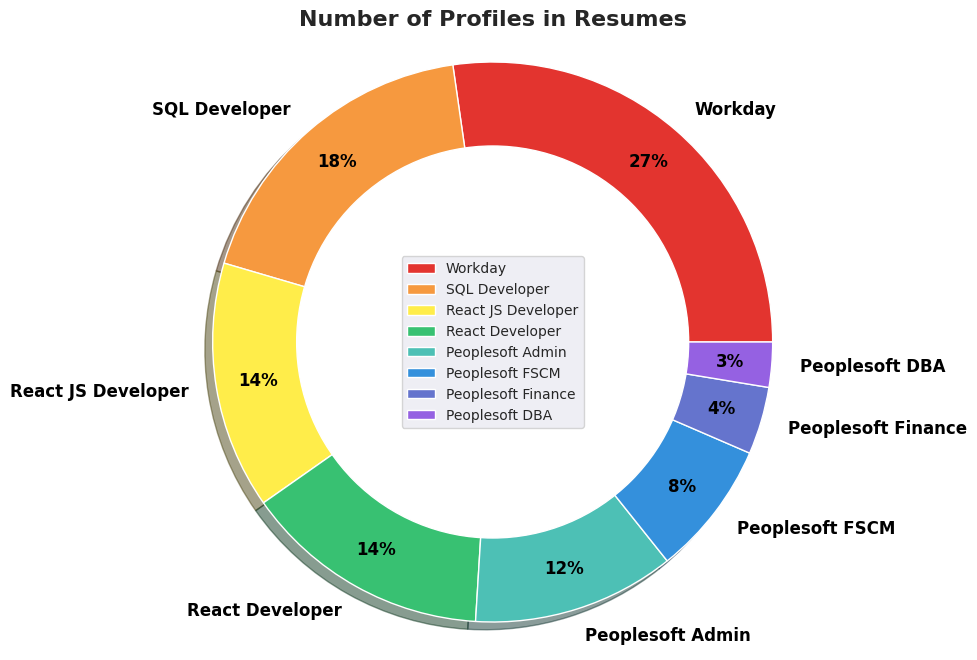

In [21]:
plt.figure(figsize=(12,8)) 
# Setting size in Chart based on 
# given values

sizes = data.Profile.value_counts()
  
# Setting labels for items in Chart
labels = data.Profile.value_counts().index
  
# colors
colors = ['#e3342f', '#f6993f', '#ffed4a', '#38c172', '#4dc0b5', '#3490dc', '#6574cd', '#9561e2', '#f66d9b' ]

  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%',shadow=True,
        pctdistance=0.85, 
        startangle=0,
        textprops = {'size':'large',
                   'fontweight':'bold',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Number of Profiles in Resumes', fontsize = 16, fontweight = 'bold')
 # Aspect ratio
plt.axis('equal')
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

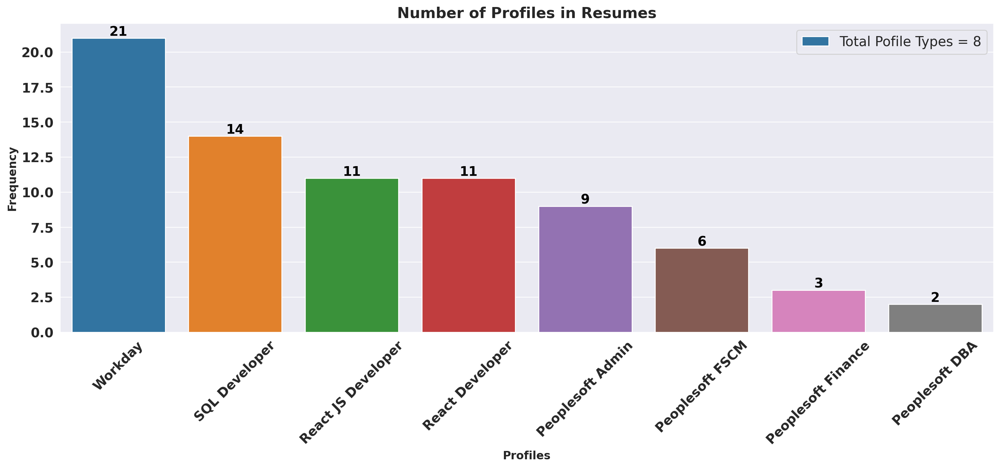

In [22]:
f, axe = plt.subplots(1,1, figsize=(18,6), dpi=200)
ax = sns.barplot(x=data.Profile.value_counts().index, y=data.Profile.value_counts(), data=data, ax = axe,
            label='Total Pofile Types = {}'.format(len(data.Profile.unique())))
axe.set_xlabel('Profiles', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=14,fontweight = 'bold')
plt.xticks(fontsize=14,fontweight = 'bold', rotation = 45)
plt.legend(loc='best', fontsize  = 'x-large')
plt.title('Number of Profiles in Resumes', fontsize = 16, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 14)
plt.show()

### Reading a Resume File

In [23]:
import docx2txt
 
def extract_text_from_docx(docx_path):
    txt = docx2txt.process(docx_path)
    if txt:
        return txt.replace('\t', ' ')
    return None
 
if __name__ == '__main__':
    print(extract_text_from_docx('/content/drive/MyDrive/Resumes_docx/Peoplesoft Admin/Peoplesoft Admin_AnubhavSingh.docx'))

Anubhav Kumar Singh



 To work in a globally competitive environment on  
 challenging assignments that shall yield the  
 twin benefits of the job satisfaction and a steady-paced   professional growth. 



Core Competencies:

 Scripting  : Shell Scripting 

 Application  : PeopleSoft HCM, FINANCIALS 

 Operating System  : Linux ,Windows 

 Web/App Servers  : Weblogic, Tuxedo 

 RDBMS  : Oracle 

 Repository  : Github 







 Professional Experience 

 06/2019 - Current 

 07/2017- 06/2019 

HCL 
Current Role: System Admin Offshore 
Skills : Shell Scripting, Linux , PeopleSoft Administration , Github 



•

•

•

•
•
•
•
•
•
•
•
•

Managing PeopleSoft HCM and PeopleSoft FSCM production environments along with support environments installed on Linux and Windows OS. 

Involved in Day to Day activities such as Project Migration, Database Refresh, System admin changes, Tax updates etc. 

Troubleshooting of various servers like application servers, Web Servers, Process Scheduler Servers. 

In [24]:
df = pd.read_csv('/content/Resume2Text_Extracted.csv')

In [25]:
df

,Resumes,Profiles
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft
1,Classification: Internal\n\nClassification: In...,Peoplesoft
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft
...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday


In [26]:
df[df.Profiles=='SQL Developer']

,Resumes,Profiles
42,ANIL KUMAR MADDUKURI \t\t\n\nSQL & MSBI Devel...,SQL Developer
43,Aradhana Tripathi\n\n\n\nCurrent Location: Gac...,SQL Developer
44,BUDDHA VAMSI ...,SQL Developer
45,KAMBALLA PRADEEP ...,SQL Developer
46, Hyderabad\n\n\nNazeer Basha\n\nSQL and Power...,SQL Developer
47,Resume\n\nName : Neeraj Mishra\n\n\n\nExp...,SQL Developer
48,SQL DEVELOPER\n\nName: - Bandi prem sai\n\n\...,SQL Developer
49,SQL SERVER DEVELOPER\n\n\n\n\n\nPriyanka L ...,SQL Developer
50,SQL SERVER DEVELOPER\n\n\n\n\n\nP. Syam Kumar ...,SQL Developer
51,RAJU PAVANA KUMARI\n\n\n\n\t\n\n\tProfessional...,SQL Developer


Data Exploration

In [27]:
df[df.duplicated()].shape

(0, 2)

In [28]:
df[df.duplicated()]

,Resumes,Profiles


In [29]:
df.isnull().any()

Resumes     False
Profiles    False
dtype: bool

In [30]:
df.isnull().sum()

Resumes     0
Profiles    0
dtype: int64

#### Number of Words

In [31]:
df['word_count'] = df['Resumes'].apply(lambda x: len(str(x).split(" ")))
df[['Resumes','word_count']].head()

,Resumes,word_count
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,1023
1,Classification: Internal\n\nClassification: In...,558
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",455
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,918
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,1641


In [32]:
%matplotlib inline

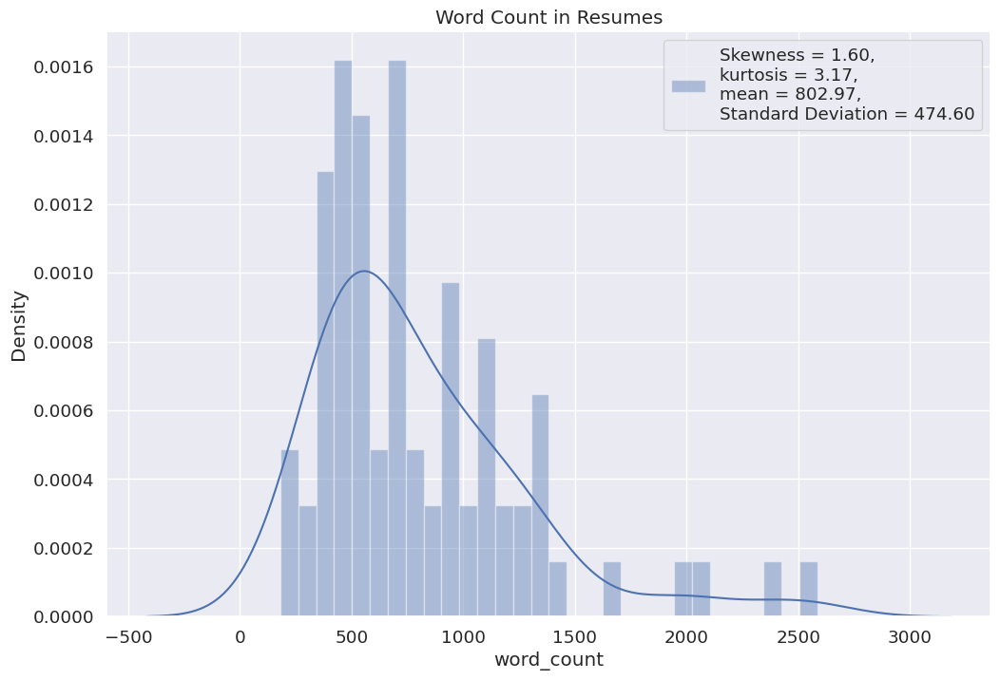

In [33]:
skew = df['word_count'].skew()
kurt = df['word_count'].kurt()
mean = df['word_count'].mean()
std = df['word_count'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["word_count"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Word Count in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of characters

In [34]:
df['char_count'] = df['Resumes'].str.len() ## this also includes spaces
df[['Resumes','char_count']].head()

,Resumes,char_count
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,8010
1,Classification: Internal\n\nClassification: In...,4917
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",3800
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,7943
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,11121


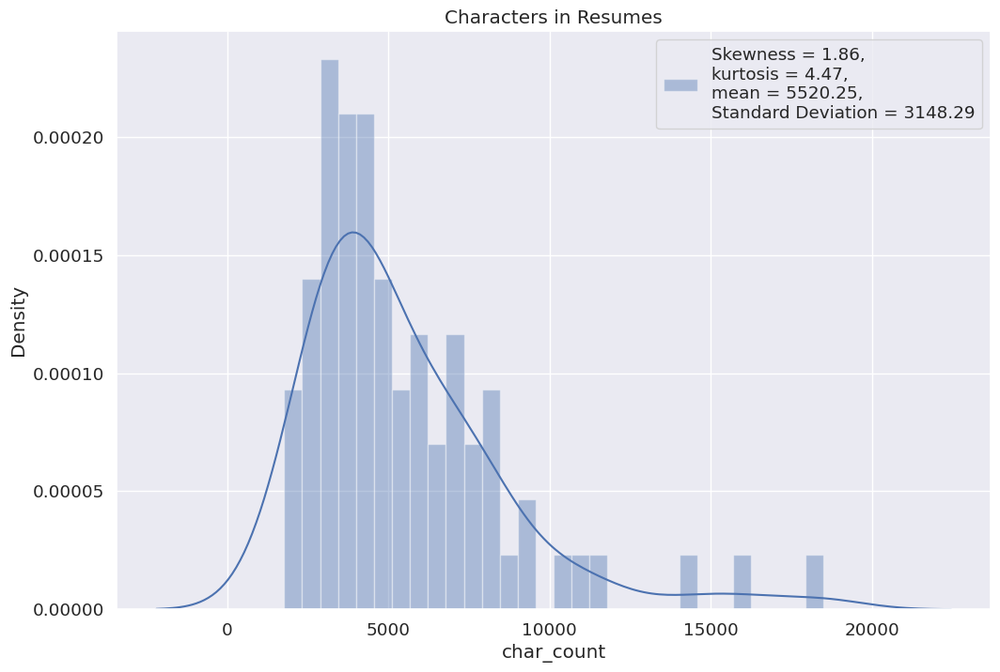

In [35]:
skew = df['char_count'].skew()
kurt = df['char_count'].kurt()
mean = df['char_count'].mean()
std = df['char_count'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["char_count"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Characters in Resumes')
plt.legend(loc='best')
plt.show()

#### Average Word Length in each Resumes

In [36]:
def avg_word(sentence):
    words = sentence.split()
    return (sum(len(word) for word in words)/len(words))

df['avg_word'] = df['Resumes'].apply(lambda x: avg_word(x))
df[['Resumes','avg_word']].head()

,Resumes,avg_word
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,6.415929
1,Classification: Internal\n\nClassification: In...,6.317817
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",6.109162
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,6.575787
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,6.429279


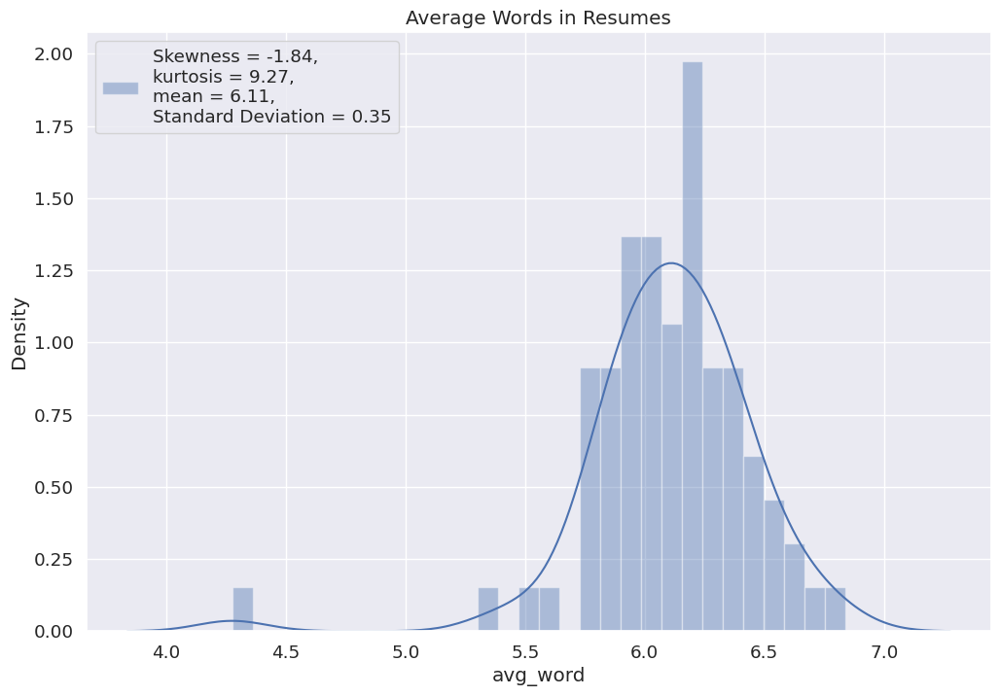

In [37]:
skew = df['avg_word'].skew()
kurt = df['avg_word'].kurt()
mean = df['avg_word'].mean()
std = df['avg_word'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["avg_word"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Average Words in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of stopwords

In [38]:
from nltk.corpus import stopwords
stop = stopwords.words('english')

df['stopwords'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x in stop]))
df[['Resumes','stopwords']].head()

,Resumes,stopwords
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,190
1,Classification: Internal\n\nClassification: In...,114
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",86
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,225
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,303


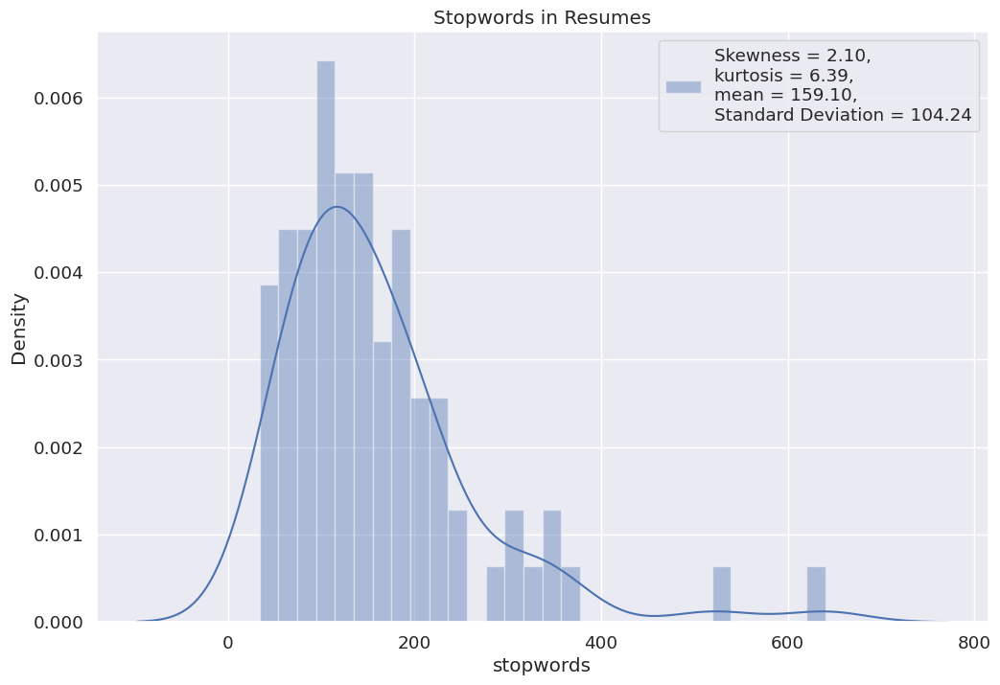

In [39]:
skew = df['stopwords'].skew()
kurt = df['stopwords'].kurt()
mean = df['stopwords'].mean()
std = df['stopwords'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["stopwords"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Stopwords in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of numerics

In [40]:
df['numerics'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x.isdigit()]))
df[['Resumes','numerics']].head()

,Resumes,numerics
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,4
1,Classification: Internal\n\nClassification: In...,7
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",15
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,4
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,16


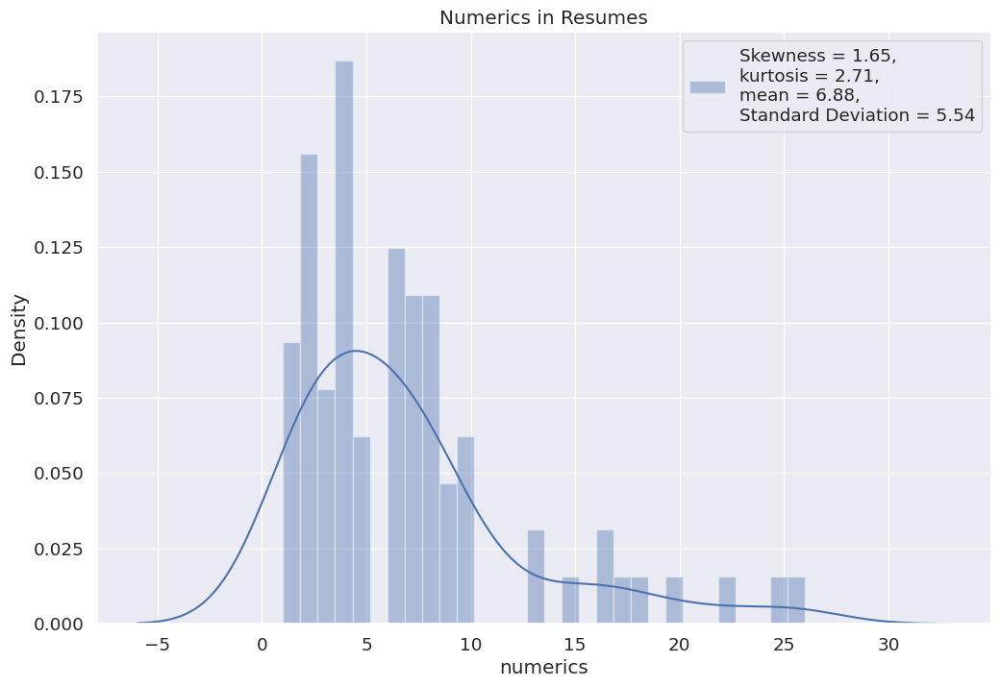

In [41]:
skew = df['numerics'].skew()
kurt = df['numerics'].kurt()
mean = df['numerics'].mean()
std = df['numerics'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["numerics"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Numerics in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of Uppercase words

In [42]:
df['uppercase'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x.isupper()]))
df[['Resumes','uppercase']].head()

,Resumes,uppercase
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,60
1,Classification: Internal\n\nClassification: In...,53
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",77
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,58
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,85


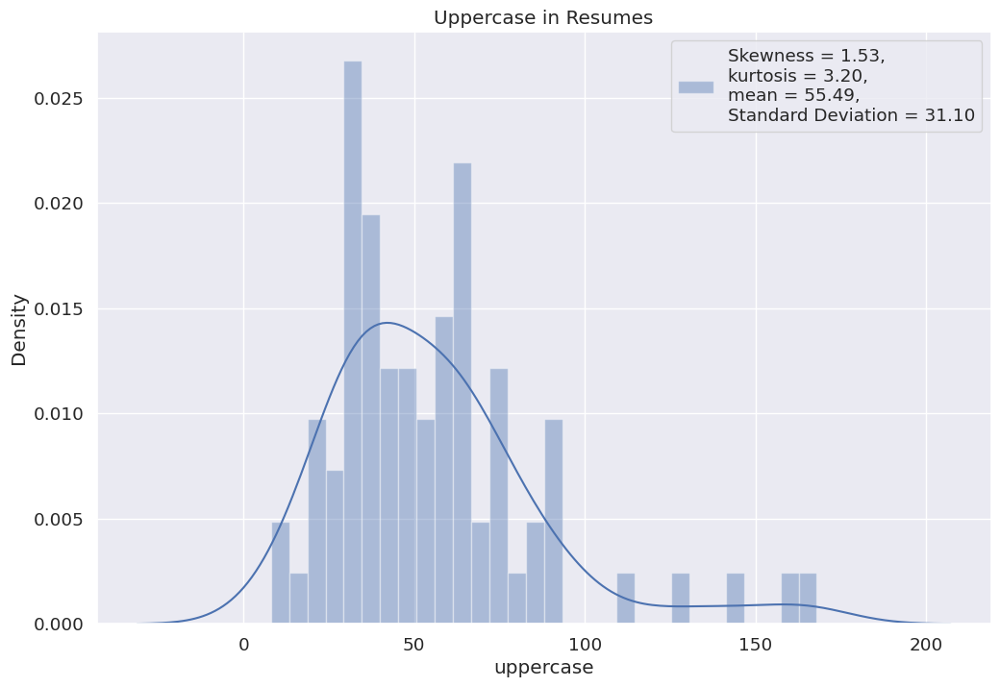

In [43]:
skew = df['uppercase'].skew()
kurt = df['uppercase'].kurt()
mean = df['uppercase'].mean()
std = df['uppercase'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["uppercase"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Uppercase in Resumes')
plt.legend(loc='best')
plt.show()

In [44]:
df.to_csv('Counts_extracted.csv', index=False)
df = pd.read_csv('Counts_extracted.csv')
df

,Resumes,Profiles,word_count,char_count,avg_word,stopwords,numerics,uppercase
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft,1023,8010,6.415929,190,4,60
1,Classification: Internal\n\nClassification: In...,Peoplesoft,558,4917,6.317817,114,7,53
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft,455,3800,6.109162,86,15,77
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft,918,7943,6.575787,225,4,58
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft,1641,11121,6.429279,303,16,85
...,...,...,...,...,...,...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday,904,7030,6.442391,197,3,57
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday,1063,6737,5.995570,194,9,85
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday,1076,8329,6.030810,236,6,69
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday,1031,6836,6.272418,193,7,46


#### Percentage of Links attached in the Resumes

In [45]:
(df.Resumes.str.contains('https://').value_counts() / len(df))*100

False    90.909091
True      9.090909
Name: Resumes, dtype: float64

In [46]:
links = (df.Resumes.str.contains('https://').value_counts() / len(df))*100
No_links = links[0]
Yes_links = links[1]

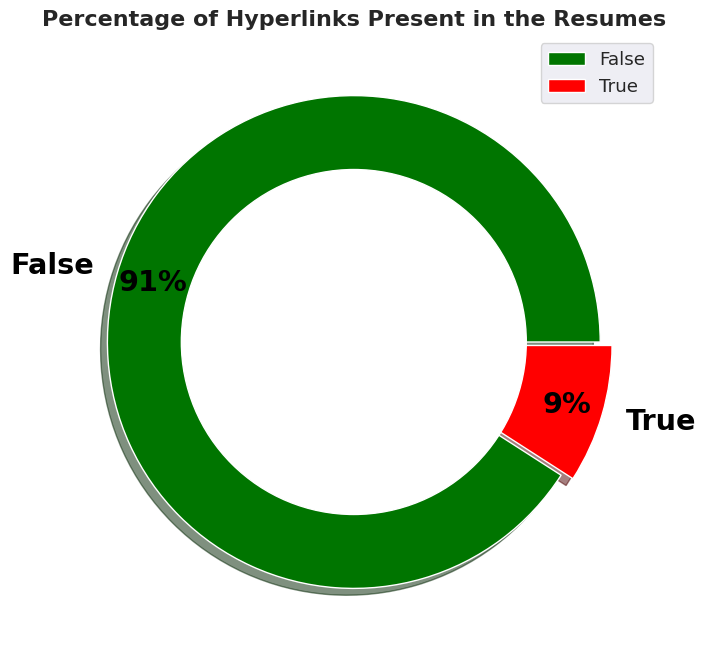

In [47]:
plt.figure(figsize=(12,8)) 
# Setting size in Chart based on 
# given values

sizes = [No_links, Yes_links]
  
# Setting labels for items in Chart
labels = ['False', 'True']
  
# colors
colors = ['#007500', '#FF0000']
  
# explosion
explode = (0.0, 0.05)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%', shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'x-large',
                   'fontweight':'bold',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Percentage of Hyperlinks Present in the Resumes', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="upper right")
  
# Displaying Chart
plt.show()

Text Pre-Processing

Removing Punctuations, Numbers and Special characters
This step should not be followed if we also want to do sentiment analysis on key phrases as well, because semantic meaning in a sentence needs to be present. So here we will create one additional column 'absolute_tidy_tweets' which will contain absolute tidy words which can be further used for sentiment analysis on key words.

h. Removing Stop words With the same reason we mentioned above, we won't perform this on 'tidy_tweets' column, because it needs to be used for key_phrases sentiment analysis.

Tokenize 'Resumes'
Converting words to Lemma

In [48]:
import re
import string
import nltk
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer,PorterStemmer
from nltk.corpus import stopwords
lemmatizer = WordNetLemmatizer()
stemmer = PorterStemmer() 
nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [49]:
def preprocess(sentence):
    sentence=str(sentence)
    sentence = sentence.lower()
    sentence=sentence.replace('{html}',"") 
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, '', sentence)
    rem_url=re.sub(r'http\S+', '',cleantext)
    rem_num = re.sub('[0-9]+', '', rem_url)
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(rem_num)  
    filtered_words = [w for w in tokens if len(w) > 2 if not w in stopwords.words('english')]
    stem_words=[stemmer.stem(w) for w in filtered_words]
    lemma_words=[lemmatizer.lemmatize(w) for w in stem_words]
    return " ".join(filtered_words)

In [50]:
df = pd.read_csv('/content/Resume2Text_Extracted.csv')
df['Clean_Resumes']=df.Resumes.apply(lambda x: preprocess(x))
df.to_csv('Cleaned_Resumes.csv', index = False)

In [51]:
df = pd.read_csv('Cleaned_Resumes.csv')
df

,Resumes,Profiles,Clean_Resumes
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft,anubhav kumar singh core competencies scriptin...
1,Classification: Internal\n\nClassification: In...,Peoplesoft,classification internal classification interna...
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft,sirazuddin bangalore india sirazuddin bangalor...
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft,peoplesoft admin varkala vikas career objectiv...
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft,peoplesoft admin peoplesoft dba ganesh alladi ...
...,...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday,workday integration consultant name sri krishn...
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday,srikanth workday hcm consultant seeking suitab...
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday,workday hcm fcm name kumar role workday consul...
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday,venkateswarlu workday consultant professional ...


In [52]:
df.Resumes[20]

'Kanumuru Deepak Reddy\n\n\n\n\t\n\n\n\nCAREER OBJECTIVE:\n\n\n\nTo secure a position in a reputed organization where I can efficiently contribute my knowledge and skills to the growth of the organization and build my professional career.\n\n\n\nACADEMIC QUALIFICATIONS:\n\n\n\n\n\nQualification\n\nInstitute\n\nBoard (or) University\n\nYear of completion\n\nPercentage/CGPA\n\nB.Tech (E.C.E)\n\nAudisankara College of Engineering & Technology,Gudur.\n\nJNTU Anantapur.\n\n2018\n\n77.3\n\nIntermediate\n\nNarayana Junior college, Naidupet.\n\nBoard of\n\nIntermediate, AP.\n\n2014\n\n89.5\n\nSSC\n\nNavodaya High School,Naidupet\n\nBoard of Secondary education, AP.\n\n2012\n\n6.7\n\n\n\nPROJECT:\n\n\n\nTitle\t:Density based Traffic Control System USING ARDUINO.\n\n\n\nDuration:4 months.\n\n\n\nDescription: Traffic congestion is a severe problem in most of the cities across the world and it has become a nightmare for the citizens. It is caused by delay in signal, inappropriate timing of traffic

In [53]:
df.Clean_Resumes[20]

'kanumuru deepak reddy career objective secure position reputed organization efficiently contribute knowledge skills growth organization build professional career academic qualifications qualification institute board university year completion percentage cgpa tech audisankara college engineering technology gudur jntu anantapur intermediate narayana junior college naidupet board intermediate ssc navodaya high school naidupet board secondary education project title density based traffic control system using arduino duration months description traffic congestion severe problem cities across world become nightmare citizens caused delay signal inappropriate timing traffic signalling etc delay traffic light hard coded depend traffic therefore optimising traffic control increasing demand systematic quick automatic system project designed develop density based dynamic traffic signal control signal timing changes automatically sensing traffic density junction microcontroller used project arduin

Data Exploration
Now its time to explore the preprocessed and cleaned text reviews. Textual data can be explored using Word Clouds. These are visual representations of the frequency of different words present in text. Importance of words are represented by size of the word. Bigger size represents more frequently occuring words

N-grams
N-grams are the combination of multiple words used together. Ngrams with N=1 are called unigrams. Similarly, bigrams (N=2), trigrams (N=3) and so on can also be used.

Unigrams do not usually contain as much information as compared to bigrams and trigrams. The basic principle behind n-grams is that they capture the language structure, like what letter or word is likely to follow the given one. The longer the n-gram (the higher the n), the more context you have to work with. Optimum length really depends on the application – if your n-grams are too short, you may fail to capture important differences. On the other hand, if they are too long, you may fail to capture the “general knowledge” and only stick to particular cases.

So, let’s quickly extract bigrams from our tweets using the ngrams function of the textblob library.

In [54]:
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [55]:
TextBlob(df['Resumes'][1]).ngrams(1)[:20]

[WordList(['Classification']),
 WordList(['Internal']),
 WordList(['Classification']),
 WordList(['Internal']),
 WordList(['Murali']),
 WordList(['Experience']),
 WordList(['Summary']),
 WordList(['I']),
 WordList(['have']),
 WordList(['6']),
 WordList(['years']),
 WordList(['of']),
 WordList(['experience']),
 WordList(['working']),
 WordList(['in']),
 WordList(['PeopleSoft']),
 WordList(['Administration']),
 WordList(['and']),
 WordList(['performing']),
 WordList(['various'])]

In [56]:
TextBlob(df['Resumes'][1]).ngrams(2)[:20]

[WordList(['Classification', 'Internal']),
 WordList(['Internal', 'Classification']),
 WordList(['Classification', 'Internal']),
 WordList(['Internal', 'Murali']),
 WordList(['Murali', 'Experience']),
 WordList(['Experience', 'Summary']),
 WordList(['Summary', 'I']),
 WordList(['I', 'have']),
 WordList(['have', '6']),
 WordList(['6', 'years']),
 WordList(['years', 'of']),
 WordList(['of', 'experience']),
 WordList(['experience', 'working']),
 WordList(['working', 'in']),
 WordList(['in', 'PeopleSoft']),
 WordList(['PeopleSoft', 'Administration']),
 WordList(['Administration', 'and']),
 WordList(['and', 'performing']),
 WordList(['performing', 'various']),
 WordList(['various', 'infrastructure'])]

In [57]:
TextBlob(df['Resumes'][1]).ngrams(3)[:20]

[WordList(['Classification', 'Internal', 'Classification']),
 WordList(['Internal', 'Classification', 'Internal']),
 WordList(['Classification', 'Internal', 'Murali']),
 WordList(['Internal', 'Murali', 'Experience']),
 WordList(['Murali', 'Experience', 'Summary']),
 WordList(['Experience', 'Summary', 'I']),
 WordList(['Summary', 'I', 'have']),
 WordList(['I', 'have', '6']),
 WordList(['have', '6', 'years']),
 WordList(['6', 'years', 'of']),
 WordList(['years', 'of', 'experience']),
 WordList(['of', 'experience', 'working']),
 WordList(['experience', 'working', 'in']),
 WordList(['working', 'in', 'PeopleSoft']),
 WordList(['in', 'PeopleSoft', 'Administration']),
 WordList(['PeopleSoft', 'Administration', 'and']),
 WordList(['Administration', 'and', 'performing']),
 WordList(['and', 'performing', 'various']),
 WordList(['performing', 'various', 'infrastructure']),
 WordList(['various', 'infrastructure', 'related'])]

In [58]:
df['Clean_Resumes']

0     anubhav kumar singh core competencies scriptin...
1     classification internal classification interna...
2     sirazuddin bangalore india sirazuddin bangalor...
3     peoplesoft admin varkala vikas career objectiv...
4     peoplesoft admin peoplesoft dba ganesh alladi ...
                            ...                        
72    workday integration consultant name sri krishn...
73    srikanth workday hcm consultant seeking suitab...
74    workday hcm fcm name kumar role workday consul...
75    venkateswarlu workday consultant professional ...
76    vinay kumar workday functional consultant expe...
Name: Clean_Resumes, Length: 77, dtype: object

In [59]:
from sklearn.feature_extraction.text import CountVectorizer
c_vec = CountVectorizer(stop_words=stopwords.words('english'), ngram_range=(1,2))
# matrix of ngrams
ngrams = c_vec.fit_transform(df['Clean_Resumes'])
# count frequency of ngrams
count_values = ngrams.toarray().sum(axis=0)
# list of ngrams
vocab = c_vec.vocabulary_
df_ngram = pd.DataFrame(sorted([(count_values[i],k) for k,i in vocab.items()], reverse=True)
            ).rename(columns={0: 'frequency', 1:'unigram/bigram'})

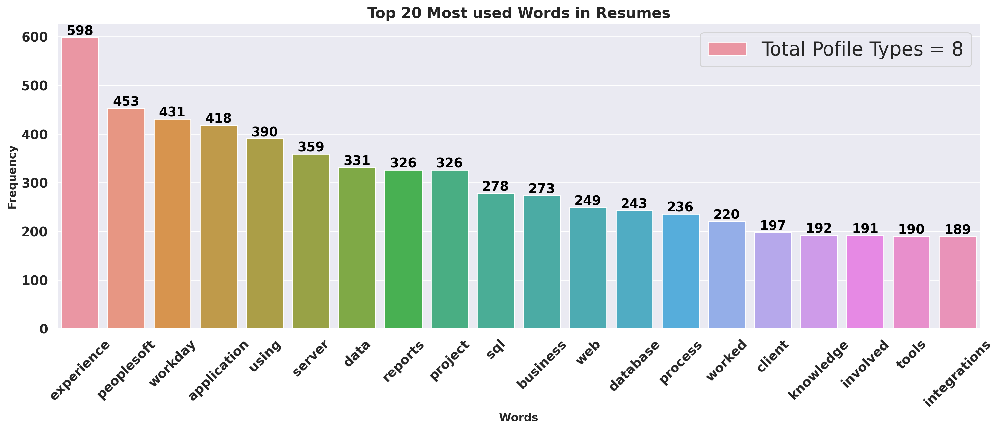

In [60]:
f, axe = plt.subplots(1,1, figsize=(18,6), dpi=200)
ax = sns.barplot(x=df_ngram['unigram/bigram'].head(20), y=df_ngram.frequency.head(20), data=data, ax = axe,
            label='Total Pofile Types = {}'.format(len(data.Profile.unique())))
axe.set_xlabel('Words', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=14,fontweight = 'bold')
plt.xticks(fontsize=14,fontweight = 'bold', rotation = 45)
plt.legend(loc='best', fontsize  = 'x-large')
plt.title('Top 20 Most used Words in Resumes', fontsize = 16, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 14)
plt.show()

Generate Word Cloud

In [61]:
oneSetOfStopWords = set(stopwords.words('english')+['``',"''"])
totalWords =[]
Sentences = df['Clean_Resumes'].values
cleanedSentences = ""
for records in Sentences:
    cleanedText = preprocess(records)
    cleanedSentences += cleanedText
    requiredWords = nltk.word_tokenize(cleanedText)
    for word in requiredWords:
        if word not in oneSetOfStopWords and word not in string.punctuation:
            totalWords.append(word)
    
wordfreqdist = nltk.FreqDist(totalWords)
mostcommon = wordfreqdist.most_common(50)
print(mostcommon)

[('experience', 598), ('peoplesoft', 453), ('workday', 431), ('application', 418), ('using', 390), ('server', 359), ('data', 331), ('project', 326), ('reports', 326), ('sql', 278), ('business', 273), ('web', 249), ('database', 243), ('process', 236), ('worked', 220), ('client', 197), ('knowledge', 192), ('involved', 191), ('tools', 190), ('integrations', 189), ('system', 187), ('hcm', 182), ('like', 180), ('integration', 180), ('support', 178), ('development', 168), ('team', 166), ('creating', 164), ('skills', 163), ('working', 162), ('people', 160), ('technical', 158), ('services', 157), ('report', 155), ('design', 154), ('servers', 152), ('good', 150), ('created', 150), ('react', 148), ('responsibilities', 147), ('various', 146), ('oracle', 142), ('role', 142), ('environment', 139), ('developer', 139), ('testing', 138), ('eib', 134), ('production', 133), ('security', 133), ('management', 132)]


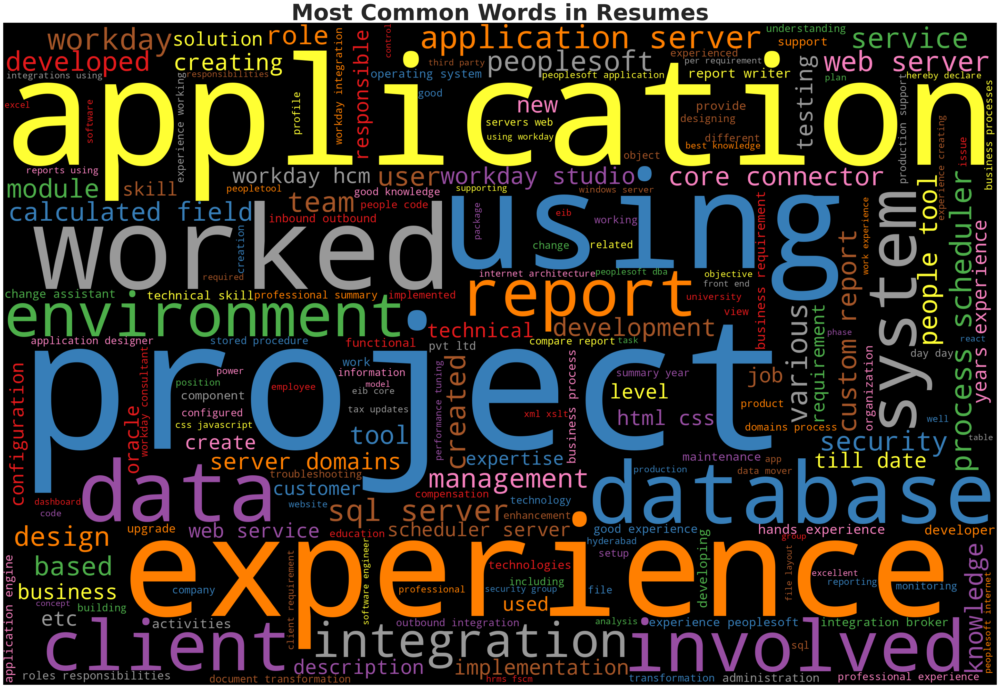

In [62]:
from wordcloud import WordCloud
# Define a function to plot word cloud
def plot_cloud(wordcloud):
    plt.figure(figsize=(40,30))
    plt.imshow(wordcloud)
    plt.title('Most Common Words in Resumes', fontsize = 50, fontweight = 'bold')
    plt.axis('off')
    plt.show()
    
# Generate Word Cloud

#STOPWORDS.add('pron')
#STOPWORDS.add('rt')
#STOPWORDS.add('yeah')
wordcloud=WordCloud(width=3000,height=2000,background_color='black',max_words=200,
                   colormap='Set1').generate(cleanedSentences)

plot_cloud(wordcloud)

Story Generation and Visualization

A. Most common words in Different Profile Resumes
Answer can be best found using WordCloud

In [63]:
def generate_wordcloud(all_words, Profile):
    wordcloud = WordCloud(width=800, height=500,background_color='black',max_words=200,
                   colormap='Set1').generate(all_words)

    plt.figure(figsize=(14, 10), dpi=200)
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title('Most Common Words in {} Resumes'.format(Profile), fontsize = 16, fontweight = 'bold')
    plt.show()

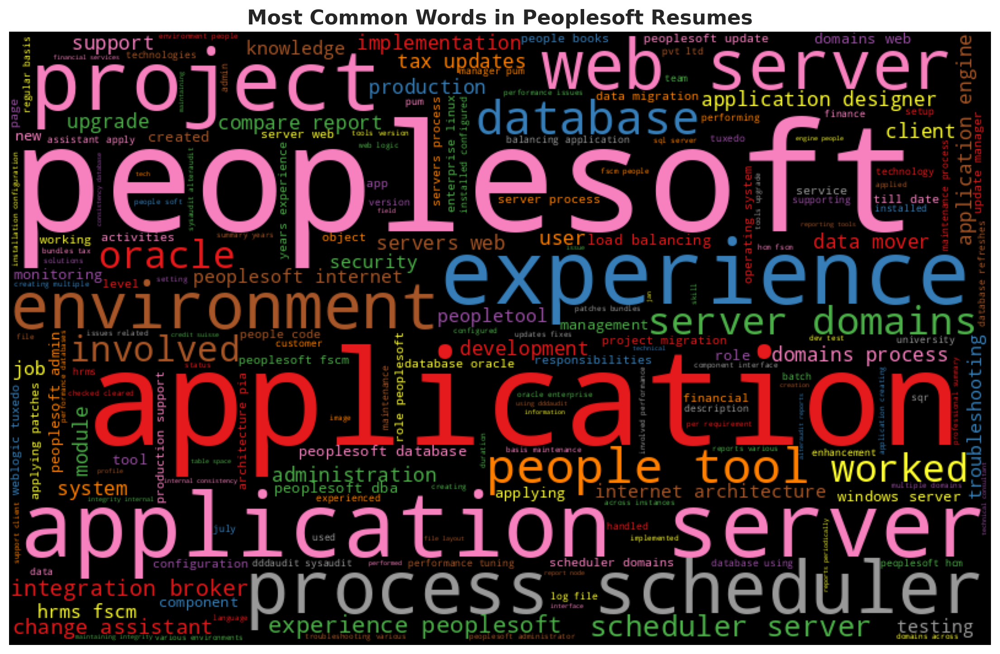

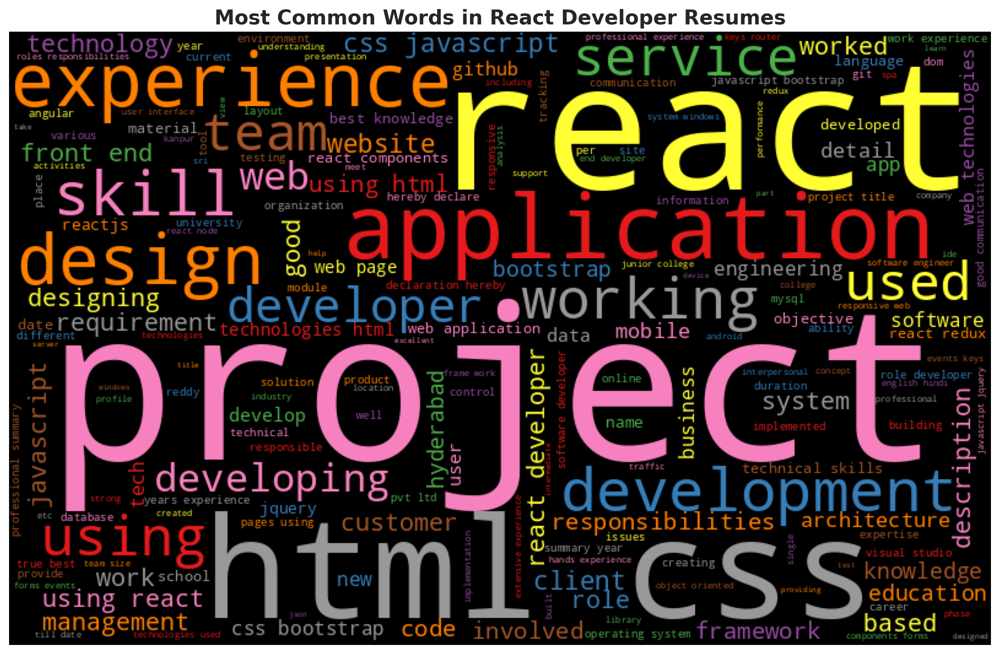

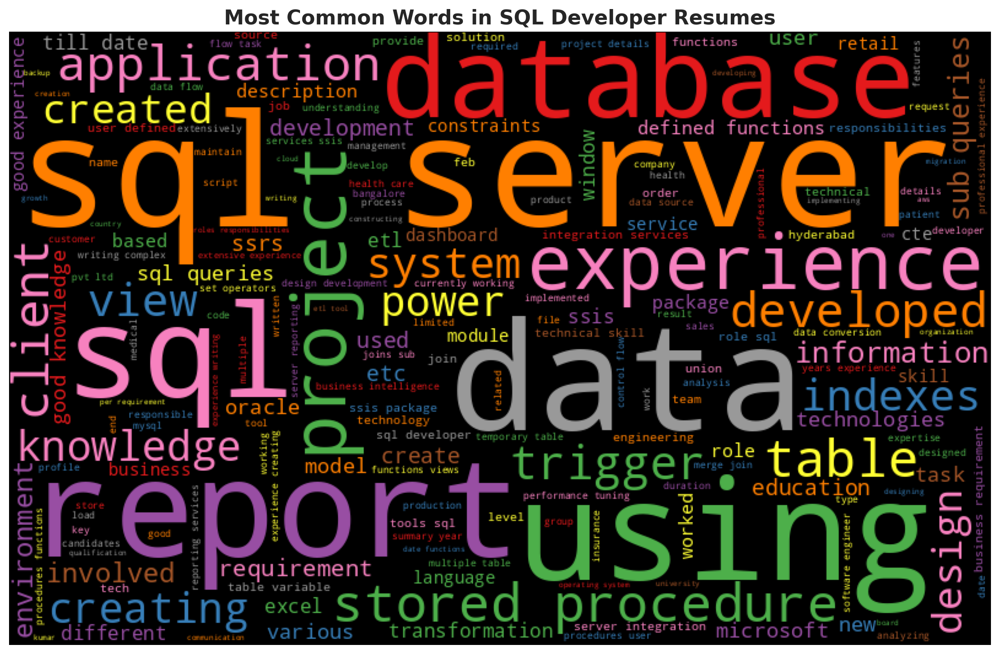

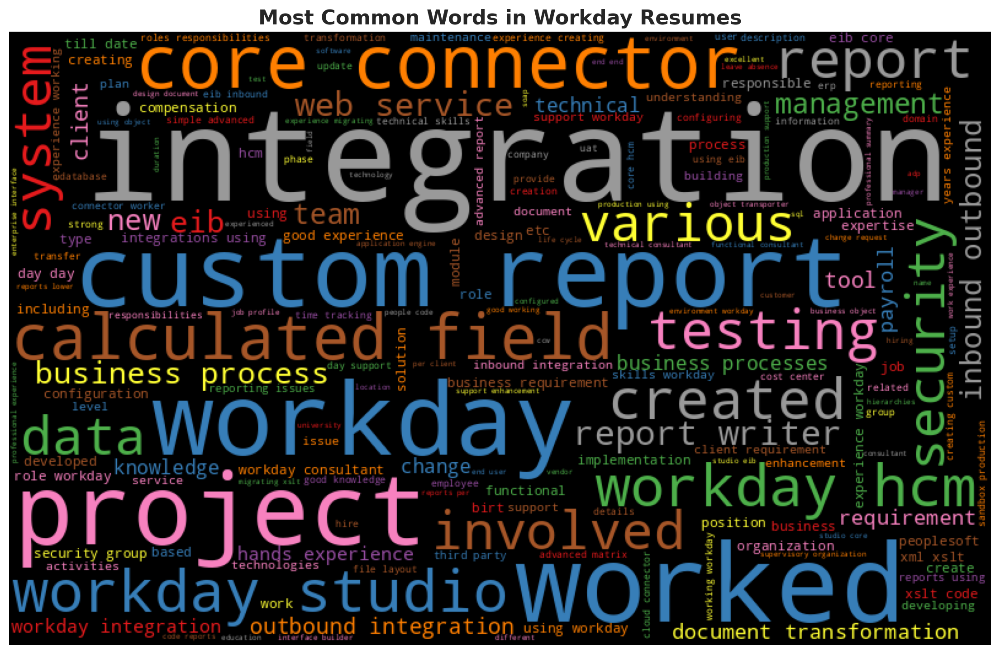

In [64]:
for profiles in df.Profiles.unique():
    all_words = ' '.join([text for text in df['Clean_Resumes'][df.Profiles == profiles]])
    generate_wordcloud(all_words, profiles)

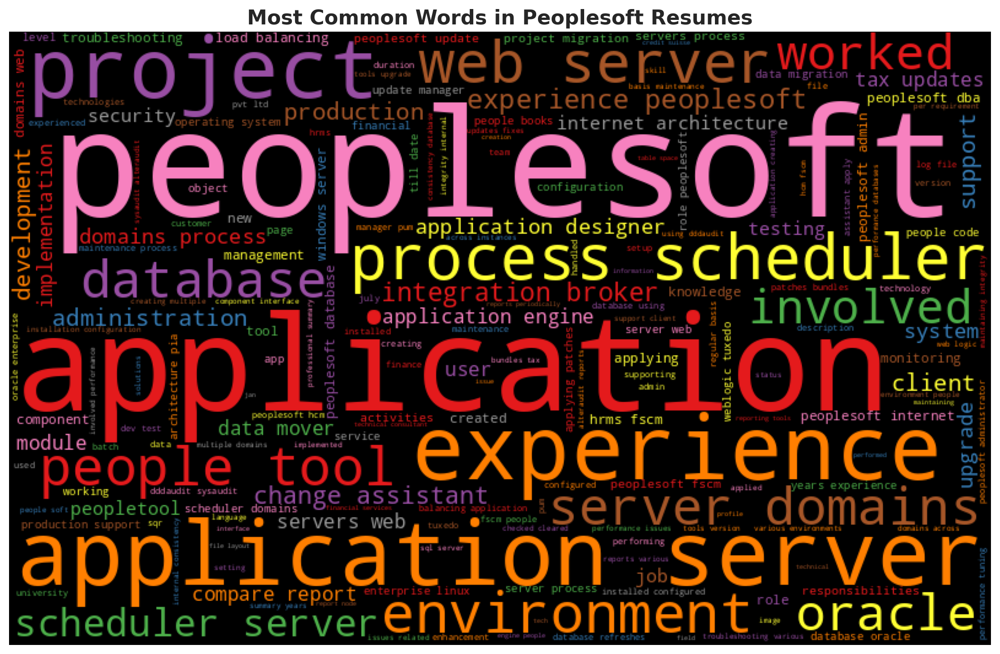

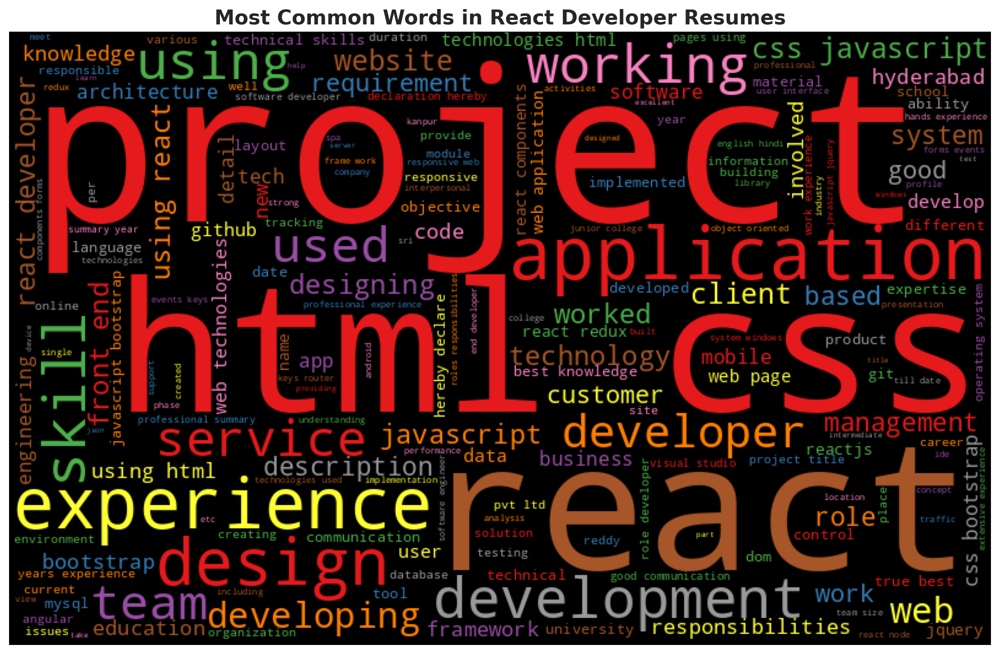

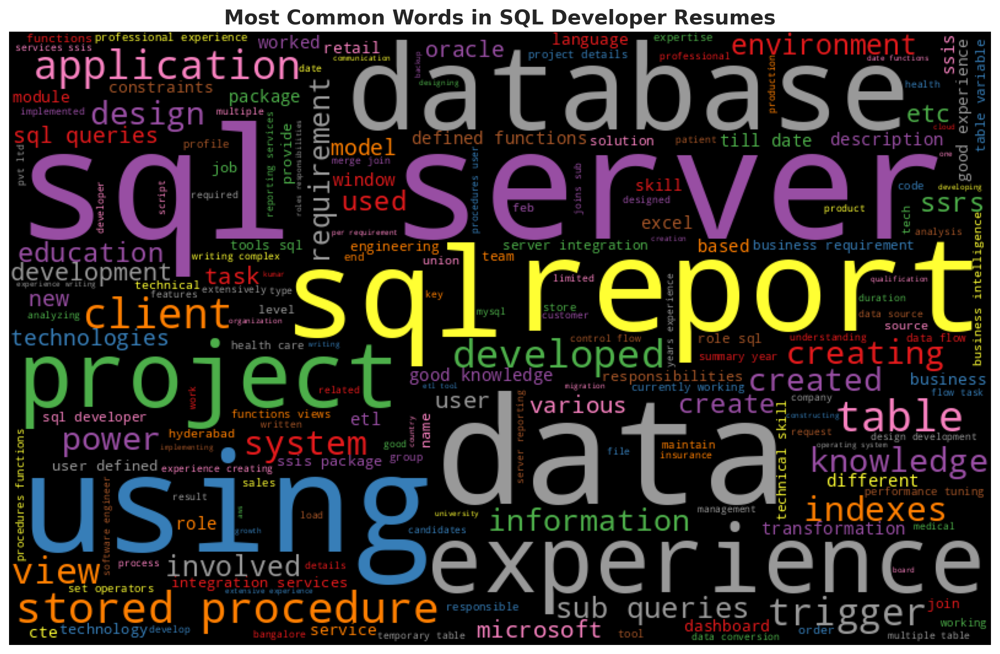

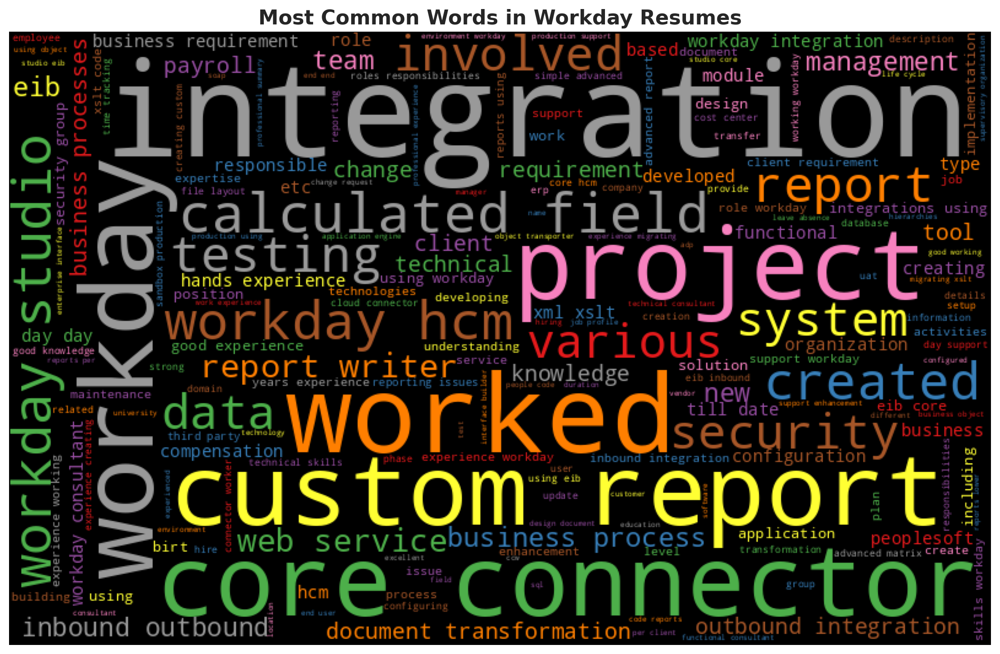

In [65]:
for profiles in df.Profiles.unique():
    all_words = ' '.join([text for text in df['Clean_Resumes'][df.Profiles == profiles]])
    generate_wordcloud(all_words, profiles)

In [66]:
categories = np.sort(df['Profiles'].unique())
categories

array(['Peoplesoft', 'React Developer', 'SQL Developer', 'Workday'],
      dtype=object)

In [67]:
df_categories = [df[df['Profiles'] == category].loc[:, ['Clean_Resumes', 'Profiles']] for category in categories]

In [68]:
def wordfreq(df):
    count = df['Clean_Resumes'].str.split(expand=True).stack().value_counts().reset_index()
    count.columns = ['Word', 'Frequency']

    return count.head(10)

In [69]:
for i, category in enumerate(categories):
    print(category)

Peoplesoft
React Developer
SQL Developer
Workday


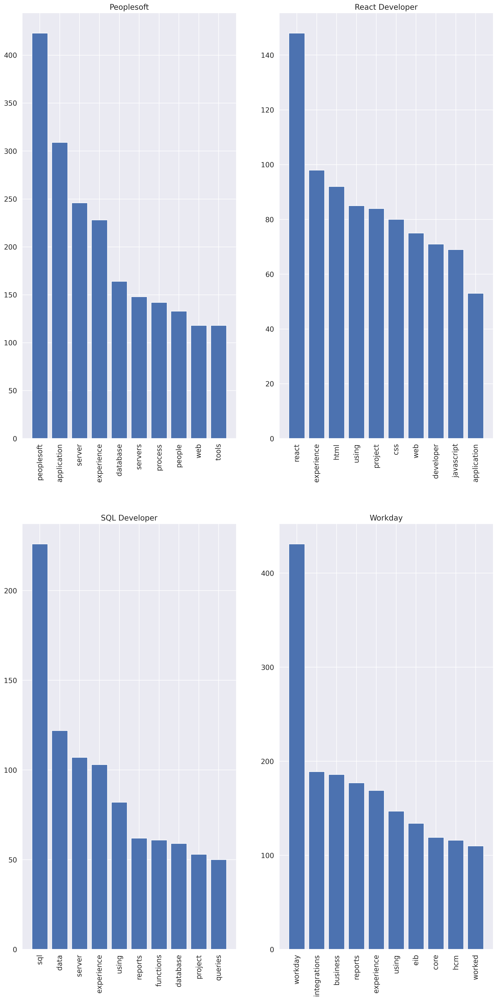

In [70]:
fig = plt.figure(figsize=(16, 32), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(2, 2, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=90)

plt.show()

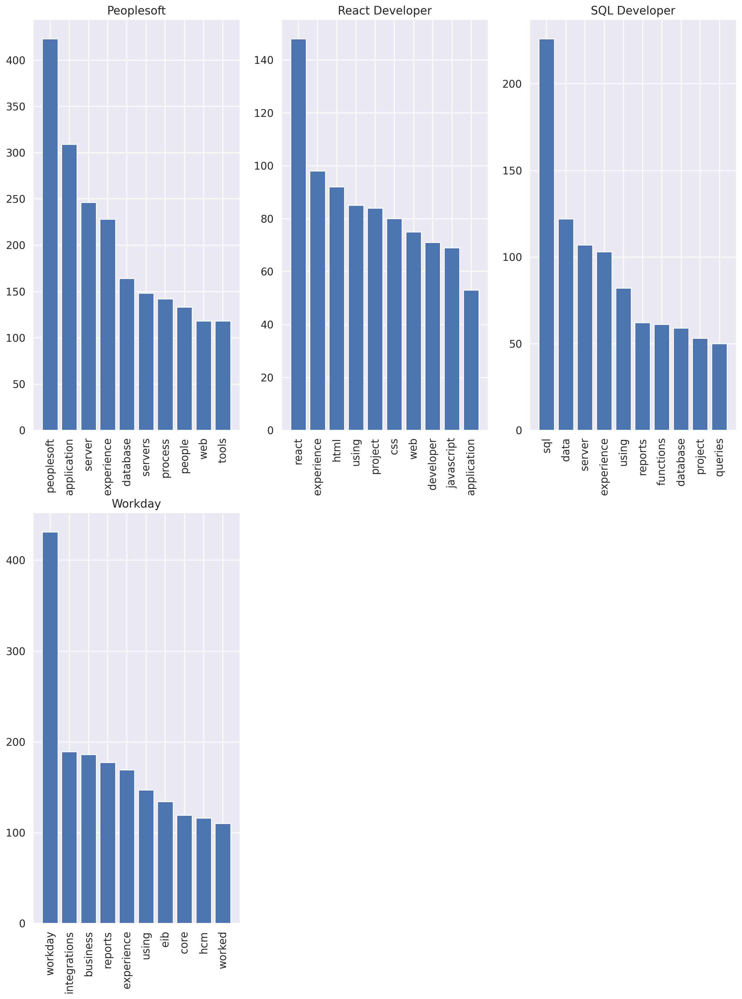

In [71]:
fig = plt.figure(figsize=(16, 32), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(3, 3, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=90)

plt.show()

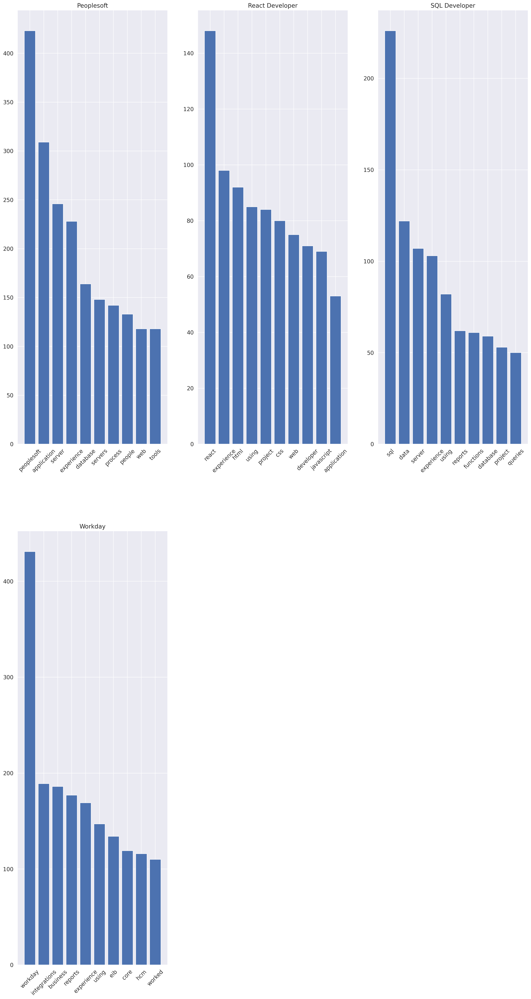

In [72]:
fig = plt.figure(figsize=(22, 64), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(3, 3, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=45)

plt.show()

Named Entity Recognition (NER)

In [73]:
!pip install -U spacy
!python -m spacy download en_core_web_lg


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
2023-06-11 12:57:41.295129: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 587.7/587.7 MB 3.0 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [74]:
# Parts Of Speech (POS) Tagging
import spacy
nlp=spacy.load('en_core_web_lg')

one_block=cleanedSentences[:2000]
doc_block=nlp(one_block)
spacy.displacy.render(doc_block,style='ent',jupyter=True)

In [75]:
for token in doc_block[:50]:
    print(token,token.pos_)  

anubhav PROPN
kumar PROPN
singh PROPN
core PROPN
competencies NOUN
scripting VERB
shell NOUN
scripting NOUN
application NOUN
peoplesoft PROPN
hcm PROPN
financials NOUN
operating VERB
system NOUN
linux PROPN
windows PROPN
web NOUN
app NOUN
servers NOUN
weblogic PROPN
tuxedo PROPN
rdbms VERB
oracle PROPN
repository PROPN
github PROPN
core PROPN
competencies NOUN
scripting VERB
shell NOUN
scripting NOUN
application NOUN
peoplesoft PROPN
hcm PROPN
financials NOUN
operating VERB
system NOUN
linux PROPN
windows PROPN
web NOUN
app NOUN
servers NOUN
weblogic PROPN
tuxedo PROPN
rdbms VERB
oracle PROPN
repository PROPN
github PROPN
work VERB
globally ADV
competitive ADJ


Filtering out only the nouns and verbs from the Text to Tokens

#### Filtering out only the nouns and verbs from the Text to Tokens

In [76]:
# Filtering the nouns and verbs only
one_block=cleanedSentences
doc_block=nlp(one_block)
nouns_verbs=[token.text for token in doc_block if token.pos_ in ('NOUN','VERB')]
print(nouns_verbs[100:200])

['docker', 'developing', 'shell', 'scripts', 'troubleshooting', 'shell', 'script', 'failures', 'project', 'application', 'support', 'automation', 'devops', 'tools', 'peoplesoft', 'admin', 'skills', 'shell', 'project', 'people', 'tools', 'upgrade', 'application', 'upgrade', 'project', 'migration', 'applications', 'ntt', 'worked', 'shell', 'scripting', 'application', 'requirement', 'working', 'automated', 'start', 'stop', 'activities', 'application', 'knowledge', 'docker', 'applying', 'released', 'applications', 'worked', 'search', 'configuration', 'peoplesoft', 'gained', 'knowledge', 'aws', 'resources', 'understanding', 'unix', 'architecture', 'command', 'trouble', 'shooting', 'using', 'configuration', 'management', 'deployment', 'tool', 'experience', 'job', 'scheduling', 'workload', 'knowledge', 'automation', 'using', 'shell', 'scripting', 'integration', 'management', 'using', 'installing', 'configuring', 'writing', 'playbook', 'perform', 'task', 'managed', 'administration', 'tasks', '

 Counting all the nouns and verbs present in the Tokens of words

In [77]:
# Counting the noun & verb tokens
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()

X=cv.fit_transform(nouns_verbs)
sum_words=X.sum(axis=0)

words_freq=[(word,sum_words[0,idx]) for word,idx in cv.vocabulary_.items()]
words_freq=sorted(words_freq, key=lambda x: x[1], reverse=True)

wd_df=pd.DataFrame(words_freq)
wd_df.columns=['word','count']
wd_df[0:10] # viewing top ten results

,word,count
0,experience,543
1,application,417
2,using,379
3,workday,353
4,reports,326
5,data,306
6,project,289
7,business,260
8,server,243
9,web,236


Visualizing the Result of Top 10 nouns and verbs most frequently present in the Resumes

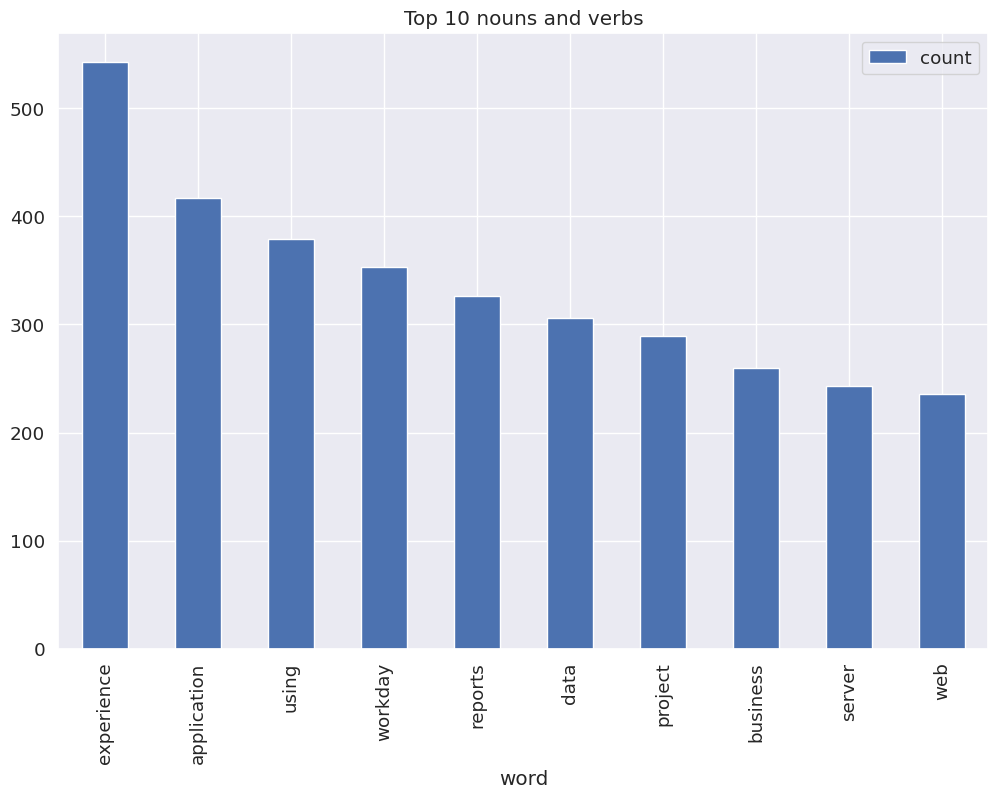

In [78]:
# Visualizing results (Barchart for top 10 nouns + verbs)
wd_df[0:10].plot.bar(x='word',figsize=(12,8),title='Top 10 nouns and verbs')
plt.show()

Basic Feature Extaction

Applying bag of Words without N grams

In [79]:
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()
tweetscv=cv.fit_transform(requiredWords)

In [80]:
print(cv.vocabulary_)

{'vinay': 257, 'kumar': 122, 'workday': 262, 'functional': 94, 'consultant': 41, 'expertise': 88, 'summary': 221, 'years': 270, 'total': 239, 'experience': 86, 'knowledge': 121, 'modules': 145, 'core': 44, 'hcm': 101, 'supervisory': 222, 'organization': 158, 'delegation': 59, 'cost': 45, 'center': 20, 'locations': 130, 'security': 207, 'implementing': 106, 'integrations': 112, 'various': 255, 'including': 108, 'compensation': 30, 'time': 237, 'tracking': 242, 'absence': 1, 'management': 135, 'payroll': 165, 'benefits': 12, 'performance': 170, 'good': 97, 'groups': 99, 'role': 198, 'based': 11, 'user': 251, 'job': 119, 'experienced': 87, 'report': 189, 'writing': 267, 'custom': 49, 'reports': 191, 'simple': 212, 'advanced': 5, 'matrix': 138, 'composite': 33, 'calculated': 18, 'fields': 91, 'eib': 72, 'connectors': 40, 'xml': 268, 'xslt': 269, 'web': 258, 'services': 210, 'structure': 218, 'objects': 154, 'hands': 100, 'migrating': 142, 'code': 26, 'lower': 131, 'tenant': 233, 'sandbox':

In [81]:

print(cv.get_feature_names()[109:200])

['independent', 'information', 'integration', 'integrations', 'interface', 'interfaces', 'internal', 'interpersonal', 'involved', 'issues', 'job', 'keys', 'knowledge', 'kumar', 'languages', 'layout', 'leadership', 'legacy', 'like', 'loading', 'location', 'locations', 'lower', 'mahindra', 'maintain', 'managed', 'management', 'mass', 'master', 'matrix', 'members', 'menus', 'microsoft', 'migrating', 'modifications', 'modified', 'modules', 'monitor', 'monitored', 'moving', 'multiple', 'narayana', 'needed', 'new', 'object', 'objects', 'one', 'online', 'order', 'organization', 'organizations', 'outbound', 'output', 'ownership', 'pages', 'payments', 'payroll', 'people', 'peoplesoft', 'per', 'perform', 'performance', 'performing', 'personal', 'player', 'powerpoint', 'process', 'processes', 'processing', 'production', 'professional', 'project', 'prompt', 'publisher', 'queries', 'query', 'ran', 'ready', 'records', 'relationships', 'report', 'reporting', 'reports', 'requests', 'requirement', 'req

In [102]:
print(cv.get_feature_names()[:100])

['abil', 'abil work', 'abil work team', 'absenc', 'absenc manag', 'academ', 'accentur', 'accept', 'accept level', 'accept level statu', 'accept test', 'access', 'access peopl', 'access peopl book', 'accord', 'accord chang', 'accord chang request', 'accord client', 'account', 'account inform', 'account inform cost', 'account payabl', 'account provis', 'account provis integr', 'achiev', 'across', 'across instanc', 'across instanc monitor', 'across instanc troubleshoot', 'action', 'activ', 'activ check', 'activ check clean', 'activ develop', 'activ develop team', 'activ experi', 'activ involv', 'activ like', 'ad', 'ad new', 'ad new xslt', 'adapt', 'add', 'addit', 'addm', 'addm report', 'address', 'admin', 'admin environ', 'admin environ applic', 'admin peoplesoft', 'admin peoplesoft dba', 'admin support', 'admin support client', 'administ', 'administr', 'administr applic', 'administr applic server', 'administr peoplesoft', 'administr peoplesoft dba', 'administr perform', 'administr suppor

In [82]:
print(tweetscv.toarray()[100:200])

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


CountVectorizer with N-grams (Bigrams & Trigrams)

In [83]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

  0%|          | 0/77 [00:00<?, ?it/s]

In [84]:
df.Clean_Resumes[7]

'personal details name pritam biswas date birth present location pune experience summary years experience development support maintenance upgrade peoplesoft project ibm currently working peoplesoft implementation project accenture exposure working finance module hcm module technical knowledge hands experience people tools versions worked peoplesoft hrms application versions worked technical aspects creating peoplesoft objects like field record page component file layout application engine publisher report form etc worked creating sqrs worked creating application engine worked creating publisher report worked creating query hands experience generic event mapping worked peoplesoft job job stream management iws basic idea control schedule monitor jobs basic idea service jira phire ticketing tool skills technical skills technologies peoplesoft erp hrms applications operating systems windows versions till mac programming language python beginner peoplecode sqr tools people tools oracle sql 

In [85]:
corpus[7]

'person detail name pritam biswa date birth present locat pune experi summari year experi develop support mainten upgrad peoplesoft project ibm current work peoplesoft implement project accentur exposur work financ modul hcm modul technic knowledg hand experi peopl tool version work peoplesoft hrm applic version work technic aspect creat peoplesoft object like field record page compon file layout applic engin publish report form etc work creat sqr work creat applic engin work creat publish report work creat queri hand experi gener event map work peoplesoft job job stream manag iw basic idea control schedul monitor job basic idea servic jira phire ticket tool skill technic skill technolog peoplesoft erp hrm applic oper system window version till mac program languag python beginn peoplecod sqr tool peopl tool oracl sql develop app design tectia client servicenow winscp iw control databas oracl sql server report tool sqr queri publish industri hcm financ soft skill dedic work eager adopt 

In [86]:
## Applying Countvectorizer
# Creating the Bag of Words model
cv = CountVectorizer(max_features=5000,ngram_range=(1,3))
X = cv.fit_transform(corpus).toarray()

In [87]:
X.shape

(77, 5000)

In [88]:
cv.get_params()

{'analyzer': 'word',
 'binary': False,
 'decode_error': 'strict',
 'dtype': numpy.int64,
 'encoding': 'utf-8',
 'input': 'content',
 'lowercase': True,
 'max_df': 1.0,
 'max_features': 5000,
 'min_df': 1,
 'ngram_range': (1, 3),
 'preprocessor': None,
 'stop_words': None,
 'strip_accents': None,
 'token_pattern': '(?u)\\b\\w\\w+\\b',
 'tokenizer': None,
 'vocabulary': None}

In [89]:
count_df = pd.DataFrame(X, columns=cv.get_feature_names())
count_df

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,1,1,1,2,1,0,0,1,0,0,...,0,0,0,0,0,0,0,1,1,1
73,1,0,0,7,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
74,0,0,0,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
75,1,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### <a id='6Ca'> **TF-IDF Vectorizer**</a>

In [90]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

  0%|          | 0/77 [00:00<?, ?it/s]

In [91]:
corpus[1]

'classif intern classif intern murali experi summari year experi work peoplesoft administr perform variou infrastructur relat activ peoplesoft environ instal configur peoplesoft web server applic server databas server process schedul server window unix linux platform creat domain web server applic server process schedul server appli patch manual appli mainten pack chang assist tool experi dpk instal appli tax updat fix use pum migrat project one environ anoth environ use applic design also capi stat tool perform singl sign sso implement experi run compar report pre post migrat experi set client workstat develop tester involv configur integr broker set modul send messag involv product support client involv run audit report dddaudit sysaudit integr check experi configur setup ren server configur maintain report node set check clear cach server involv troubleshoot server like applic server web server process schedul server work peopletool upgrad instal configur elast search career profil 

In [92]:
## TFidf Vectorizer
tfidf_v=TfidfVectorizer(max_features=5000,ngram_range=(1,3))
X=tfidf_v.fit_transform(corpus).toarray()

In [93]:
X.shape

(77, 5000)

In [94]:
tfidf_v.get_feature_names()[:20]

['abil',
 'abil work',
 'abil work team',
 'absenc',
 'absenc manag',
 'academ',
 'accentur',
 'accept',
 'accept level',
 'accept level statu',
 'accept test',
 'access',
 'access peopl',
 'access peopl book',
 'accord',
 'accord chang',
 'accord chang request',
 'accord client',
 'account',
 'account inform']

In [95]:
tfidf_v.get_feature_names()[4980:]

['xslt present',
 'xslt present data',
 'xtt',
 'xtt function',
 'year',
 'year experi',
 'year experi develop',
 'year experi peoplesoft',
 'year experi react',
 'year experi softwar',
 'year experi workday',
 'year extens',
 'year extens experi',
 'year industri',
 'year industri role',
 'year month',
 'year pass',
 'year profession',
 'year profession experi',
 'year workday']

In [96]:
tfidf_v.get_params()

{'analyzer': 'word',
 'binary': False,
 'decode_error': 'strict',
 'dtype': numpy.float64,
 'encoding': 'utf-8',
 'input': 'content',
 'lowercase': True,
 'max_df': 1.0,
 'max_features': 5000,
 'min_df': 1,
 'ngram_range': (1, 3),
 'norm': 'l2',
 'preprocessor': None,
 'smooth_idf': True,
 'stop_words': None,
 'strip_accents': None,
 'sublinear_tf': False,
 'token_pattern': '(?u)\\b\\w\\w+\\b',
 'tokenizer': None,
 'use_idf': True,
 'vocabulary': None}

In [97]:
tfidf_df = pd.DataFrame(X, columns=tfidf_v.get_feature_names())
tfidf_df

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,0.012073,0.016910,0.021776,0.036670,0.021776,0.0,0.0,0.018891,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.021776,0.02276,0.021776
73,0.013670,0.000000,0.000000,0.145323,0.000000,0.0,0.0,0.021389,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.024657
74,0.000000,0.000000,0.000000,0.015370,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.016345,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
75,0.013339,0.000000,0.000000,0.040517,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000


In [98]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

# requiredText = df['Clean_Resumes'].values

word_vectorizer = TfidfVectorizer(
    sublinear_tf=True,
    stop_words='english',
    max_features=5000,
    ngram_range=(1,3))
tfidf=word_vectorizer.fit(corpus)
WordFeatures = word_vectorizer.transform(corpus).toarray()

tfidf_df = pd.DataFrame(WordFeatures, columns=tfidf.get_feature_names())
tfidf_df

  0%|          | 0/77 [00:00<?, ?it/s]

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,0.019378,0.027142,0.034952,0.049828,0.034952,0.0,0.0,0.030321,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.034952,0.036532,0.034952
73,0.021592,0.000000,0.000000,0.096600,0.000000,0.0,0.0,0.033785,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.038945
74,0.000000,0.000000,0.000000,0.024153,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.025686,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
75,0.020138,0.000000,0.000000,0.051782,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000


In [99]:
tfidf_df.to_csv('tfidf.csv', index = False)

In [100]:
import pickle

pickle.dump(tfidf, open("tfidf.pkl", "wb"))

Feature Extraction
We need to convert textual representation in the form on numeric features. We have two popular techniques to perform feature extraction:

Bag of words (Simple vectorization)

TF-IDF (Term Frequency - Inverse Document Frequency) *italicized text*
We will use extracted features from both one by one to perform sentiment analysis and will compare the result at last.

A. Feature Extraction for 'Key Words

In [101]:
# BOW features
bow_word_vectorizer = CountVectorizer(max_df=0.90, min_df=2, stop_words='english')
# bag-of-words feature matrix
bow_word_feature = bow_word_vectorizer.fit_transform(df['Clean_Resumes'])

# TF-IDF features
tfidf_word_vectorizer = TfidfVectorizer(max_df=0.90, min_df=2, stop_words='english')
# TF-IDF feature matrix
tfidf_word_feature = tfidf_word_vectorizer.fit_transform(df['Clean_Resumes'])